# AR1 Observation report

## File to be processed

In [1]:
filename="/var/kat/archive3/data/MeerKATAR1/telescope_products/2018/05/05/1525509459.h5"


## Set up environment

In [2]:
%pylab inline

Populating the interactive namespace from numpy and matplotlib


In [3]:
import katdal
import scape
import pickle
import katpoint

## Load static flags

In [4]:
#pickle_file = open('/var/kat/katsdpscripts/RTS/rfi_mask.pickle')
pickle_file = open('/var/kat/katsdpscripts/RTS/rfi_mask.pickle')
rfi_static_flags = pickle.load(pickle_file)
pickle_file.close()
edge = np.tile(True,4096)
edge[slice(211,3896)] = False
static_flags = np.logical_or(edge,rfi_static_flags)

## Load data

In [5]:
data = katdal.open(filename)

DEBUG: Found int_time=3.998308486 in telstate['sdp_l0_int_time']
DEBUG: Found scale_factor_timestamp=1712000000.0 in telstate[u'i0_scale_factor_timestamp']
DEBUG: Found sync_time=1525499700.0 in telstate[u'i0_sync_time']
DEBUG: Found n_chans=4096 in telstate['sdp_l0_n_chans']
DEBUG: Found bandwidth=856000000.0 in telstate['sdp_l0_bandwidth']
DEBUG: Found center_freq=1284000000.0 in telstate['sdp_l0_center_freq']
DEBUG: Added '0408-658' [radec] (and 1 aliases)
DEBUG: Added 'LMC' [radec] (and 0 aliases)
DEBUG: Added '0506-612' [radec] (and 0 aliases)


In [6]:
N = data.shape[0]
ext = 930
step = max(int(floor(N/ext)),1)
print step

6


In [7]:
print data

Name: /var/kat/archive3/data/MeerKATAR1/telescope_products/2018/05/05/1525509459.h5 (version 3.9)
Observer: FernandoCamilo  Experiment ID: 20180505-0013
Description: 'LMC observation'
Observed from 2018-05-05 08:37:41.870 UTC to 2018-05-05 15:21:31.620 UTC
Dump rate / period: 0.25011 Hz / 3.998 s
Subarrays: 1
  ID  Antennas                            Inputs  Corrprods
   0  m001,m002,m003,m004,m005,m006,m007,m008,m009,m010,m011,m012,m013,m014,m015,m016,m017,m018,m019,m020,m021,m022,m023,m024,m025,m026,m027,m028,m029,m030,m031,m032,m033,m034,m035,m036,m037,m038,m039,m040,m041,m042,m043,m044,m045,m047,m048,m049,m050,m051,m052,m054,m055,m056,m057,m058,m059,m060,m061,m062,m063  122      7564
Spectral Windows: 1
  ID Band Product  CentreFreq(MHz)  Bandwidth(MHz)  Channels  ChannelWidth(kHz)
   0 L    bc856M4k   1284.000         856.000           4096       208.984
-------------------------------------------------------------------------------
Data selected according to the following criteri

In [8]:
data.obs_params

{'bpcal_duration': 600.0,
 'bpcal_interval': 3600.0,
 'capture_block_id': '1525509459',
 'centre_freq': 1284.0,
 'config_label': 'cf5b2af,7808a8c',
 'dbe_centre_freq': None,
 'description': 'LMC observation',
 'dry_run': False,
 'experiment_id': '20180505-0013',
 'gaincal_duration': 60.0,
 'horizon': 20.0,
 'issue_id': '',
 'max_duration': 26100.0,
 'mode': None,
 'nd_params': {'diode': 'coupler', 'off': 0, 'on': 0, 'period': -1},
 'no_capture': False,
 'no_mask': False,
 'observer': 'FernandoCamilo',
 'product': 'bc856M4k',
 'program_block_id': '',
 'projection': 'zenithal-equidistant',
 'proposal_description': '',
 'proposal_id': '2018MAY-LMC',
 'quorum': 0.9,
 'reduction_label': None,
 'sb_id_code': '20180505-0013',
 'script_arguments': '/home/kat/katsdpcatalogues/LMC.csv --horizon=20 -t 600 -g 60 -b 600 -i 3600 -m 26100 --description=LMC observation --proposal-id=2018MAY-LMC --sb-id-code=20180505-0013 --description=LMC observation --observer=FernandoCamilo --config-label=cf5b2af,78

In [9]:
data.timestamps[1] - data.timestamps[0]

3.9983084201812744

In [10]:
data.select()
ants = data.ants
for ant in ants:
    print ant.description

m001, -30:42:39.8, 21:26:38.0, 1035.0, 13.5, 1.126 -171.761 1.0605 5868.979 5869.998, -0:42:08.0 0 0:01:44.0 0:01:11.9 -0:00:14.0 -0:00:21.0 -0:36:13.1 0:01:36.2, 1.22
m002, -30:42:39.8, 21:26:38.0, 1035.0, 13.5, -32.1085 -224.2365 1.248 5871.207 5872.205, 0:40:20.2 0 -0:02:41.9 -0:03:46.8 0:00:09.4 -0:00:01.1 0:03:04.7, 1.22
m003, -30:42:39.8, 21:26:38.0, 1035.0, 13.5, -66.5155 -202.2765 0.888 5871.551 5873.425, 0:16:25.4 0 0:00:53.5 -0:02:40.6 0:00:00.9 0:00:05.7 0:34:05.6 0:02:12.3, 1.22
m004, -30:42:39.8, 21:26:38.0, 1035.0, 13.5, -123.6195 -252.9465 1.113 5871.553 5873.415, 1:02:09.3 0 -0:00:39.3 -0:01:27.7 0:00:23.3 -0:00:11.8 -0:09:00.3 0:02:24.4, 1.22
m005, -30:42:39.8, 21:26:38.0, 1035.0, 13.5, -102.088 -283.12 1.475 5877.82 5878.919, -0:07:42.6 0 -0:00:21.0 -0:04:59.5 0:00:14.7 0:00:09.6 -0:02:18.8, 1.22
m006, -30:42:39.8, 21:26:38.0, 1035.0, 13.5, -18.226 -295.4285 1.787 5879.935 5880.975, 1:54:58.0 0 -0:02:15.7 -0:02:25.3 0:00:15.1 -0:00:03.8 -0:07:50.2 0:01:28.9, 1.22
m007

Doing pol H
Debug 1830 600 65 
xxxxxxxxxxxxxxxxxxx
Doing pol V
Debug 1830 600 65 
xxxxxxxxxxxxxxxxxxx


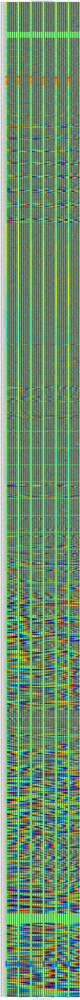

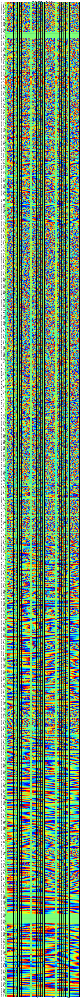

In [11]:
for active_pol in ['H','V']:
    print "Doing pol",active_pol
    data.select()
    data.select(corrprods='cross', channels=slice(2200,2800),pol=active_pol,scans=['scan','track'])
    baseline_names = [('%s - %s' % (inpA[:-1], inpB[:-1])) for inpA, inpB in data.corr_products]
    num_bls = data.shape[2]
    #num_bls=0
    num_chans, sample_period = len(data.channel_freqs), data.dump_period
    scan_targets, scan_mid_az, scan_mid_el, scan_timestamps, scan_phase = [], [], [], [], []
    for scan_ind, state, target in data.scans():
        num_ts = data.shape[0]
        ts = data.timestamps[0::step]
        vis = data.vis[0::step,:,:]
        scan_phase.append(np.angle(vis).T.reshape(-1, vis.shape[0]))
        scan_timestamps.append(ts - data.start_time.secs)
    scan_freqinds = [np.arange(num_bls * num_chans)] * len(scan_timestamps)
    print "Debug", num_bls,num_chans,len(scan_timestamps),"\nxxxxxxxxxxxxxxxxxxx"
    figure(figsize=(15,200))
    segms, labels, lines = scape.plots_basic.plot_segments(scan_timestamps, scan_freqinds,\
                                scan_phase, labels=scan_targets)
    for label in labels:
        label.set_rotation('vertical')
    plt.xlabel('Time (s), since %s' % (katpoint.Timestamp(data.start_time).local(),))
    plt.yticks(np.arange(num_chans // 2, num_bls * num_chans, num_chans), baseline_names,ha='right',y=1.0,fontsize=7)
    for yval in range(0, num_bls * num_chans, num_chans):
        plt.axhline(yval, color='k', lw=1, alpha=0.1)
        #plt.axvline(yval, color='y', lw=1, alpha=0.1)
    plt.title('Raw visibility phase per baseline, Pol %s'%active_pol)

In [12]:
print 'Report generated:'
!date

Report generated:
Mon May  7 11:44:20 UTC 2018


In [13]:
print (data.timestamps[-1] - data.timestamps[0])/3600.0 ,"Hours long"

6.72382210394 Hours long


# Comments
* m018 f-engine dead
* loads of structure on long baselines, not much on longer baselines
* m012 not phased up (delay offset)